# CAM BASIC

In [1]:
# package and module
import os
import cv2
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
# visualize
import matplotlib.pyplot as plt
# package and module
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.layers import Dense, Activation, Flatten
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Input
from tensorflow.keras.utils import to_categorical
# classification score
from sklearn.metrics import confusion_matrix, classification_report

In [2]:
plt.rcParams['figure.figsize'] = [20,15]

In [3]:
%matplotlib inline

In [4]:
# data load function
def image_load(path):
    os.chdir(path)
    files = os.listdir(path)
    data = []
    for file in files:
        f = cv2.imread(file)
        data.append(f)
    return data

In [5]:
# data load

data1 = image_load('/Users/kimtaehyeong/Desktop/Detection/02_앞면_윗니 정면')
data2 = image_load('/Users/kimtaehyeong/Desktop/Detection/05_앞면_아랫니 정면')
eye = image_load('/Users/kimtaehyeong/Desktop/outlier/eye')
dogs = image_load('/Users/kimtaehyeong/Downloads/dogs')

Premature end of JPEG file


In [6]:
teeth = data1 + data2

In [ ]:
# image visualization function
def image_visual(data_set):
    plt.figure(figsize=(15,15))
    for i in range(1,30+1):
        plt.subplot(5,6,i)
        plt.imshow(cv2.cvtColor(data_set[i], cv2.COLOR_BGR2RGB))
        plt.title(f'image {i}')
        plt.axis('off')
    plt.show()

In [ ]:
# show teeth data
image_visual(teeth)

In [ ]:
# show dog data
image_visual(dogs)

In [ ]:
# show eye data
image_visual(eye)

In [7]:
# data split
get, out = train_test_split(teeth, test_size=0.8, random_state=42)
# divide train, valid and test
train_teeth, test_teeth = train_test_split(get, test_size=0.2, random_state=42)
train_teeth, valid_teeth = train_test_split(train_teeth, test_size=0.375, random_state=42)
train_dogs, test_dogs = train_test_split(dogs, test_size=0.2, random_state=42)
train_dogs, valid_dogs = train_test_split(train_dogs, test_size=0.375, random_state=42)
train_eye, test_eye = train_test_split(eye, test_size=0.2, random_state=42)
train_eye, valid_eye = train_test_split(train_eye, test_size=0.375, random_state=42)
# merge data
train_cnn = train_teeth+train_dogs+train_eye
valid_cnn = valid_teeth+valid_dogs+valid_eye
test_cnn = test_teeth+test_dogs+test_eye

In [8]:
# print data size
print('The number of teeth class in train set:', len(train_teeth))
print('The number of teeth class in test set:', len(test_teeth))
print('The number of teeth class in valid set:', len(valid_teeth))
print('The number of dog class in train set:', len(train_dogs))
print('The number of dog class in test set:', len(test_dogs))
print('The number of dog class in valid set:', len(valid_dogs))
print('The number of eye class in train set:', len(train_eye))
print('The number of eye class in test set:', len(test_eye))
print('The number of eye class in valid set:', len(valid_eye))

The number of teeth class in train set: 582
The number of teeth class in test set: 233
The number of teeth class in valid set: 350
The number of dog class in train set: 375
The number of dog class in test set: 150
The number of dog class in valid set: 225
The number of eye class in train set: 150
The number of eye class in test set: 60
The number of eye class in valid set: 90


In [9]:
# image resize function
def image_resize(data_set, n_pixel):
    resized_list = []
    for i in range(len(data_set)):
        resized = cv2.resize(data_set[i], 
                             dsize=(n_pixel,n_pixel),
                             interpolation=cv2.INTER_CUBIC)
        resized_list.append(resized)
    return resized_list

In [10]:
# resize to 224 pixel in each data set
train_resize = image_resize(train_cnn,224)
valid_resize = image_resize(valid_cnn,224)
test_resize = image_resize(test_cnn,224)

In [11]:
# array transformation
train_array = np.array(train_resize)
valid_array = np.array(valid_resize)
test_array = np.array(test_resize)

In [12]:
# scaling to 0~1 normalization
train_scale = train_array/255.
valid_scale = valid_array/255.
test_scale = test_array/255.

In [13]:
# data labeling (teeth: 0, dog1: 1, eye: 2)
X_train = train_scale
y_train = np.zeros(len(X_train))
y_train[len(train_teeth):len(train_teeth)+len(train_dogs)] = 1
y_train[len(train_teeth)+len(train_dogs):] = 2
X_valid = valid_scale
y_valid = np.zeros(len(X_valid))
y_valid[len(valid_teeth):len(valid_teeth)+len(valid_dogs)] = 1
y_valid[len(valid_teeth)+len(valid_dogs):] = 2
X_test = test_scale
y_test = np.zeros(len(X_test))
y_test[len(test_teeth):len(test_teeth)+len(test_dogs)] = 1
y_test[len(test_teeth)+len(test_dogs):] = 2

In [14]:
# one hot encoding
y_one_hot_train = to_categorical(y_train)
y_one_hot_valid = to_categorical(y_valid)
y_one_hot_test = to_categorical(y_test)

In [70]:
y_one_hot_train

array([[1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       ...,
       [0., 0., 1.],
       [0., 0., 1.],
       [0., 0., 1.]], dtype=float32)

In [15]:
# setting random seed
np.random.seed(42)
tf.random.set_seed(42)

In [54]:
vgg_model = tf.keras.applications.VGG16(weights = 'imagenet',
                                       include_top = False,
                                       input_shape=(224,224,3))
vgg_model.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [67]:
model = tf.keras.Sequential()



for layer in vgg_model.layers[:-1]: # just exclude last layer from copying
    model.add(layer)

for layer in model.layers[:19] :
    layer.trainable = False
    
model.add(keras.layers.GlobalAveragePooling2D())
model.add(keras.layers.Dense(3, activation='softmax'))

In [68]:
model.summary()

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 56, 56, 256)     

In [75]:
# Compile the model
opt = tf.keras.optimizers.Adam(learning_rate=1e-4)
#opt = tf.keras.optimizers.RMSprop(learning_rate=1e-3)
model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

In [69]:
y_one_hot_train.shape

(1107, 3)

In [76]:
# Training the model
EPOCH = 100
history = model.fit(X_train, y_one_hot_train,
                    epochs=EPOCH,
                    validation_data=(X_valid,y_one_hot_valid),
                    shuffle=True
                    )

Epoch 1/100


2021-12-05 03:34:23.947599: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.


35/35 [==============================] - ETA: 0s - loss: 1.4262 - accuracy: 0.1960

2021-12-05 03:34:47.150226: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.


35/35 [==============================] - 36s 1s/step - loss: 1.4262 - accuracy: 0.1960 - val_loss: 1.3554 - val_accuracy: 0.2150
Epoch 2/100
35/35 [==============================] - 35s 999ms/step - loss: 1.2940 - accuracy: 0.2484 - val_loss: 1.2353 - val_accuracy: 0.2857
Epoch 3/100
35/35 [==============================] - 35s 1s/step - loss: 1.1853 - accuracy: 0.3008 - val_loss: 1.1387 - val_accuracy: 0.3203
Epoch 4/100
35/35 [==============================] - 36s 1s/step - loss: 1.0989 - accuracy: 0.3315 - val_loss: 1.0633 - val_accuracy: 0.3308
Epoch 5/100
35/35 [==============================] - 36s 1s/step - loss: 1.0316 - accuracy: 0.4110 - val_loss: 1.0046 - val_accuracy: 0.5203
Epoch 6/100
35/35 [==============================] - 36s 1s/step - loss: 0.9797 - accuracy: 0.6685 - val_loss: 0.9596 - val_accuracy: 0.7654
Epoch 7/100
35/35 [==============================] - 36s 1s/step - loss: 0.9388 - accuracy: 0.7913 - val_loss: 0.9243 - val_accuracy: 0.8045
Epoch 8/100
35/35 [===

Epoch 59/100
35/35 [==============================] - 60s 2s/step - loss: 0.3548 - accuracy: 0.8988 - val_loss: 0.3551 - val_accuracy: 0.9113
Epoch 60/100
35/35 [==============================] - 60s 2s/step - loss: 0.3496 - accuracy: 0.9033 - val_loss: 0.3498 - val_accuracy: 0.9128
Epoch 61/100
35/35 [==============================] - 60s 2s/step - loss: 0.3444 - accuracy: 0.9079 - val_loss: 0.3446 - val_accuracy: 0.9158
Epoch 62/100
35/35 [==============================] - 65s 2s/step - loss: 0.3394 - accuracy: 0.9124 - val_loss: 0.3395 - val_accuracy: 0.9203
Epoch 63/100
35/35 [==============================] - 66s 2s/step - loss: 0.3345 - accuracy: 0.9187 - val_loss: 0.3345 - val_accuracy: 0.9218
Epoch 64/100
35/35 [==============================] - 60s 2s/step - loss: 0.3296 - accuracy: 0.9187 - val_loss: 0.3296 - val_accuracy: 0.9233
Epoch 65/100
35/35 [==============================] - 60s 2s/step - loss: 0.3250 - accuracy: 0.9232 - val_loss: 0.3248 - val_accuracy: 0.9308
Epoch 

In [77]:
model.save('/Users/kimtaehyeong/Desktop/model2/my_model.h5')

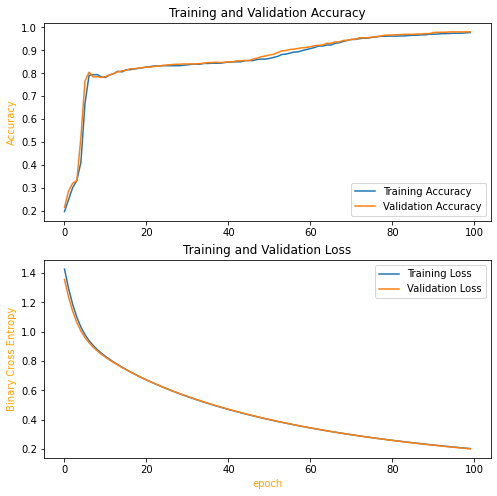

In [78]:
# check accuracy and loss
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8,8))
plt.subplot(2,1,1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy', color='orange')
#plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')
plt.subplot(2,1,2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Binary Cross Entropy', color='orange')
#plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch', color='orange')
plt.show()

In [79]:
# predict test set
prediction = model.predict(X_test)

2021-12-05 05:15:33.005837: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.


In [80]:
# 모델 평가
test_loss, test_acc = model.evaluate(X_test, y_one_hot_test, verbose=2)
print(f'Error:{test_loss}, Accuracy:{test_acc}')

14/14 - 16s - loss: 0.1902 - accuracy: 0.9819
Error:0.19019927084445953, Accuracy:0.9819413423538208


In [81]:
prediction_label = np.argmax(prediction, axis=1)
prediction_label

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

In [82]:
prediction[1,1]

0.05365305

/var/folders/f4/fb3b_sqx3rvc3gfr73v6ck_00000gn/T/ipykernel_28221/2688434663.py:8: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(n*n/4,4,i+1)


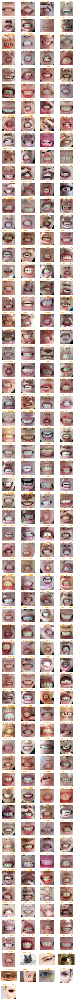

In [83]:
# check result of teeth
result = pd.DataFrame(prediction_label, columns=['value'])
teeth = result[result.value==0].index

plt.figure(figsize=(16,230))
for i in range(len(teeth)):
    n = np.ceil(np.sqrt(len(teeth)))
    plt.subplot(n*n/4,4,i+1)
    plt.imshow(cv2.cvtColor(test_cnn[teeth[i]], cv2.COLOR_BGR2RGB))
    plt.title('score:'+'{0:.4f}'.format(prediction[teeth[i],0]), fontsize=20, color='orange')
    plt.axis('off')
plt.show()

/var/folders/f4/fb3b_sqx3rvc3gfr73v6ck_00000gn/T/ipykernel_28221/420668797.py:7: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(n*n/4,4,i+1)


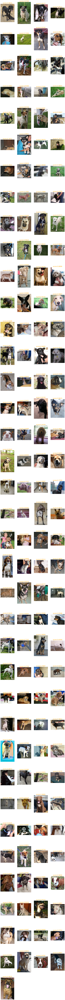

In [84]:
# check result of dog
dog = result[result.value==1].index

plt.figure(figsize=(16,280))
for i in range(len(dog)):
    n = np.ceil(np.sqrt(len(dog)))
    plt.subplot(n*n/4,4,i+1)
    plt.imshow(cv2.cvtColor(test_cnn[dog[i]], cv2.COLOR_BGR2RGB))
    plt.title('score:'+'{0:.4f}'.format(prediction[dog[i],1]), fontsize=20, color='orange')
    plt.axis('off')
plt.show()

/var/folders/f4/fb3b_sqx3rvc3gfr73v6ck_00000gn/T/ipykernel_28221/3844005355.py:7: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(n*n/4,4,i+1)


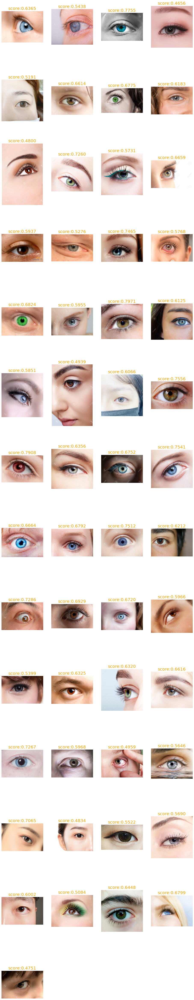

In [85]:
# check result of 
eye = result[result.value==2].index

plt.figure(figsize=(16,100))
for i in range(len(eye)):
    n = np.ceil(np.sqrt(len(eye)))
    plt.subplot(n*n/4,4,i+1)
    plt.imshow(cv2.cvtColor(test_cnn[eye[i]], cv2.COLOR_BGR2RGB))
    plt.title('score:'+'{0:.4f}'.format(prediction[eye[i],2]), fontsize=20, color='orange')
    plt.axis('off')
plt.show()

In [86]:
# check score
pred = prediction_label
print('### confusion matrix ### \n')
confusion_mat = confusion_matrix(y_test, pred)
print(confusion_mat)
print('\n\n ### each score ###')
clf_report = classification_report(y_test, pred, target_names=['teeth', 'dogs', 'eye'])
print(clf_report)

### confusion matrix ### 

[[233   0   0]
 [  1 149   0]
 [  7   0  53]]


 ### each score ###
              precision    recall  f1-score   support

       teeth       0.97      1.00      0.98       233
        dogs       1.00      0.99      1.00       150
         eye       1.00      0.88      0.94        60

    accuracy                           0.98       443
   macro avg       0.99      0.96      0.97       443
weighted avg       0.98      0.98      0.98       443



# CAM

In [87]:
from keras import backend as K

In [88]:
def extract_cam(resize_data_set,img_start_num,img_end_num):
    for i in range(img_start_num,img_end_num):
        img = resize_data_set[i]
        img_array = np.expand_dims(np.asarray(img)[:,:,:3]/255.,0)
        # get prediction result and convolution output values
        get_output = K.function([model.layers[0].input], [model.layers[-5].output, model.layers[-1].output])
        [conv_outputs, predictions] = get_output([img_array])
        class_idx = np.argmax(predictions)
        conv_outputs = conv_outputs[0,:,:,:]
        class_weights = model.layers[-1].get_weights()[0]
        # calculate cam
        cam = np.zeros(dtype=np.float32, shape=conv_outputs.shape[0:2])
        for i, w in enumerate(class_weights[:,class_idx]):
            cam += w*conv_outputs[:,:,i]
        # normalise cam and resize to fit the original image size
        cam = cam/np.max(cam)
        cam = cv2.resize(cam, (224, 224))
        # print cam image and original image
        plt.figure(figsize=(10,20))
        plt.subplot(1,2,1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.subplot(1,2,2)
        plt.imshow(cam, cmap='jet', alpha=0.8)
        plt.imshow(img, alpha=0.3)
        plt.axis('off')
        plt.show()

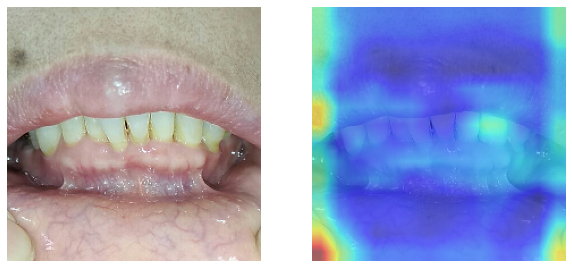

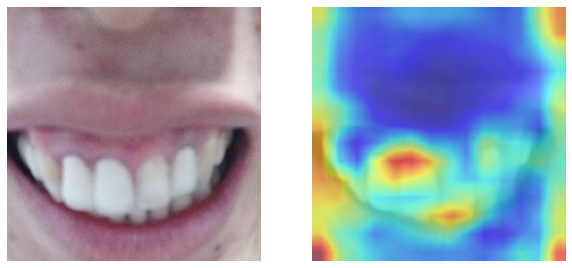

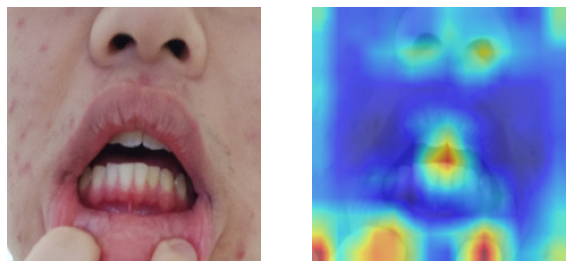

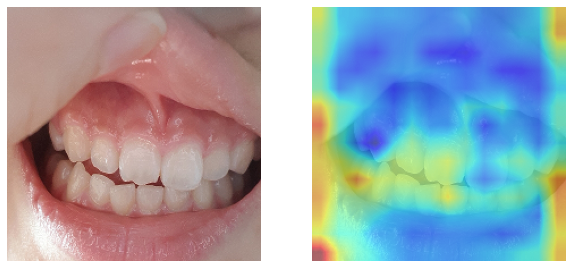

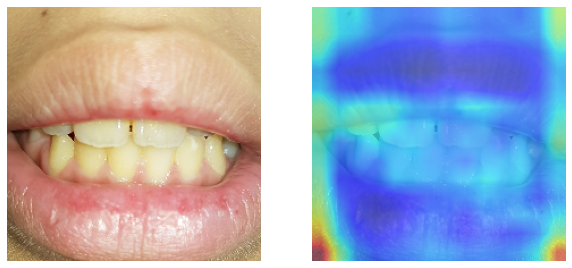

In [91]:
extract_cam(test_resize,100,105)

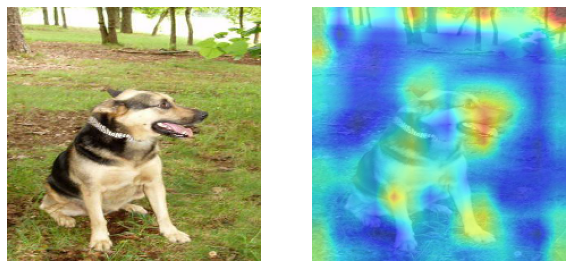

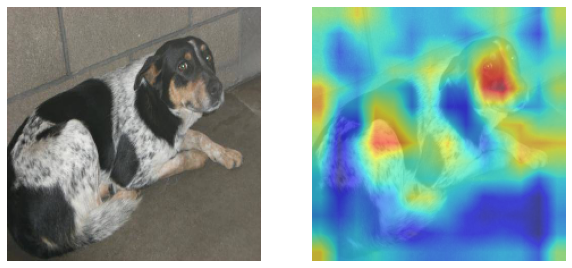

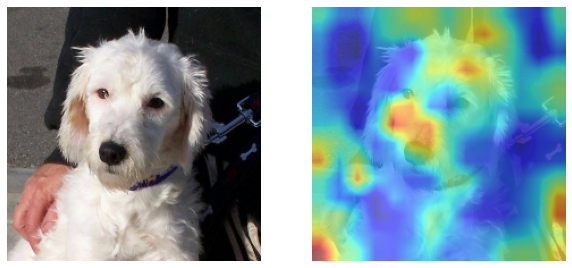

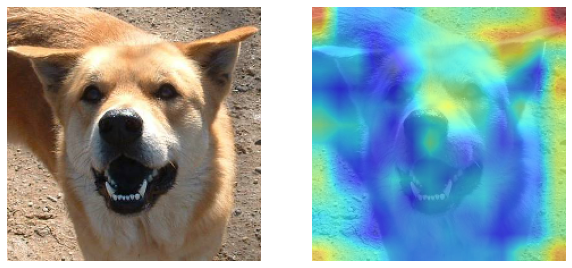

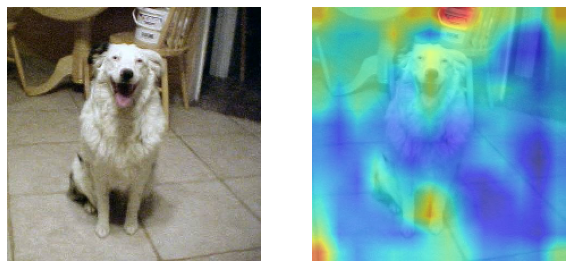

In [93]:
extract_cam(test_resize,302,307)

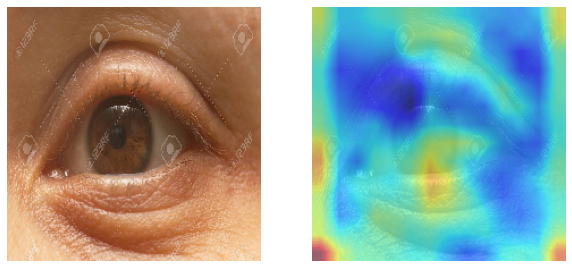

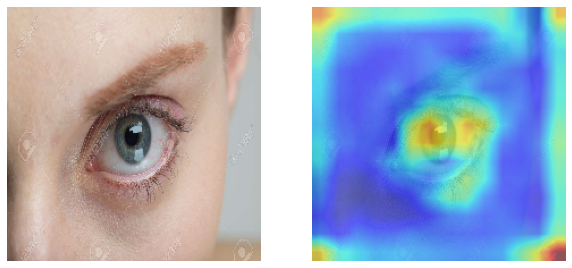

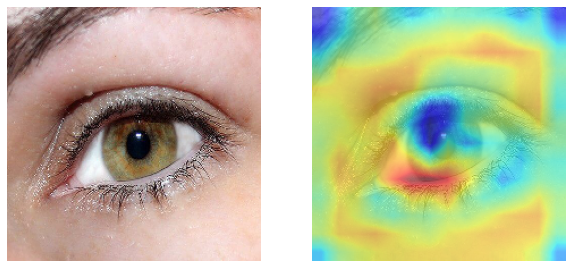

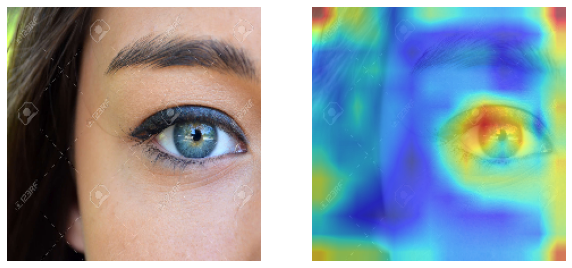

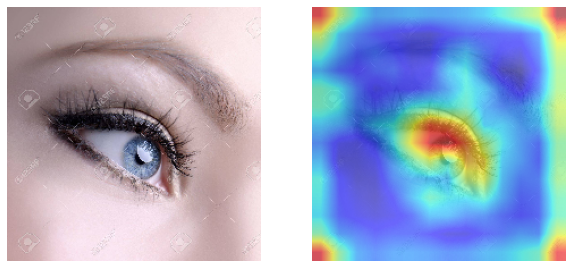

In [94]:
extract_cam(test_resize,402,407)

눈은 제대로 잡았는데..... 다른건 잘모르겠다...